## Presentation of SNN training results

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation
from pathlib import Path
import torch

Matplotlib created a temporary cache directory at /tmp/matplotlib-57po8s_i because the default path (/home/jupyter-ikharitonov/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:
%matplotlib widget

### Helper functions

In [3]:
def load_checkpoint(path):
    l = os.listdir(path)
    l = [x for x in l if x[-4:] == '.pth']
    out = []
    for f in l:
        out.append(torch.load(path/f))
    return out

def plot_loss(path):
    for checkpoint in load_checkpoint(path):
        plt.figure()
        plt.plot(checkpoint['loss_hist'])
        plt.xlabel('iteration')
        plt.ylabel('L1 loss')
        plt.show()

def plot_animations(path):
    l = os.listdir(path)
    l = [x for x in l if x[-4:] == '.npy']
    anims = []
    aarrs = []
    for f in l:
        arrs = np.load(path/f)
        # plt.close()
        out = plot_single_animation(arrs)
        anims.append(out)
        aarrs.append(arrs)
        # return plot_single_animation(arrs)
    return anims, aarrs

def plot_single_animation(arrs):

    arr1, arr2, arr3 = arrs[0], arrs[1], arrs[2]
    
    # plt.close()
    plt.rcParams["animation.html"] = "jshtml"
    # plt.rcParams['figure.dpi'] = 150
    plt.rcParams['figure.dpi'] = 80
    plt.ioff()

    fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(8,6))

    im1 = ax[0].imshow(np.zeros_like(arr1[0,:,:]), vmin=0, vmax=1)
    im2 = ax[1].imshow(np.zeros_like(arr1[0,:,:]), vmin=arr2.min(), vmax=arr2.max())
    im3 = ax[2].imshow(np.zeros_like(arr1[0,:,:]), vmin=0, vmax=1)


    def init():
        im1.set_data(np.zeros_like(arr1[0,:,:]))
        im2.set_data(np.zeros_like(arr1[0,:,:]))
        im3.set_data(np.zeros_like(arr1[0,:,:]))
        return

    def animate(t):
        im1.set_data(arr1[t,:,:]) 
        im2.set_data(arr2[t,:,:]) 
        im3.set_data(arr3[t,:,:]) 
        return

    anim = matplotlib.animation.FuncAnimation(fig, animate, init_func=init, frames=210)
    return anim

    # plt.close()

def plot_traces(arrs, neuron_i=14, neuron_j=14):
    fig, ax = plt.subplots(nrows=1, ncols=2)
    ax[0].set_title('Membrane voltage')
    ax[0].plot(arrs[1,:,neuron_i, neuron_j])
    ax[1].set_title('Spiking activity')
    ax[1].plot(arrs[2,:,neuron_i, neuron_j])
    plt.show()

In [4]:
base_path = Path.home()/'RANCZLAB-NAS/iakov/produced/mnist_sequence_checkpoints'

In [5]:
os.listdir(base_path)

['784x784_matrix_class_pure_subtract_reset_beta_0.5',
 '784x784_matrix_class_pretrained_subtract_reset_beta_0.5',
 '784x784_matrix_class_pure_zero_reset_beta_0.5',
 '784x784_matrix_class_pretrained_zero_reset_beta_0.5',
 '784x784_matrix_class_pretrained_zero_reset_beta_0.95',
 '784x784_matrix_class_pretrained_subtract_reset_beta_0.95',
 '1024x1024_matrix_class_pretrained_zero_reset_beta_0.5',
 '1024x1024_matrix_class_pretrained_subtract_reset_beta_0.95',
 '784x784_matrix_class_pure_zero_reset_beta_0.95',
 '1024x1024_matrix_class_pure_zero_reset_beta_0.5',
 '784x784_matrix_class_pure_subtract_reset_beta_0.95']

### Fixed parameters:
- general LIF parameters
- L1 loss on neuron membrane voltage (preactivation loss)
- implementation of L1 loss
- batch size = 16
- dataset size (number of sequences trained on) = 10000
- data normalised to 0-1 range
- temporal resolution of sequences (10Hz sampling) --> time in between digits = time of digit presentation = 10 frames
- learning rate = 0.0005
- 100 epochs - backpropagation after each batch of 16 sequences

### Parameters explored:
- beta membrane voltage decay rate
- reset mechanism = 'subract' or 'zero'
- weights matrix size = 784x784 or 1024x1024
- initialisation = random or from MNIST classification weights

### __784x784 random initialisation reset subtract beta 0.95__

In [6]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pure_subtract_reset_beta_0.95')
anims[0]

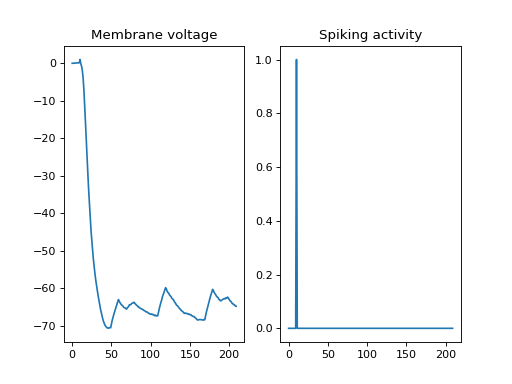

In [7]:
plot_traces(arrs[0])

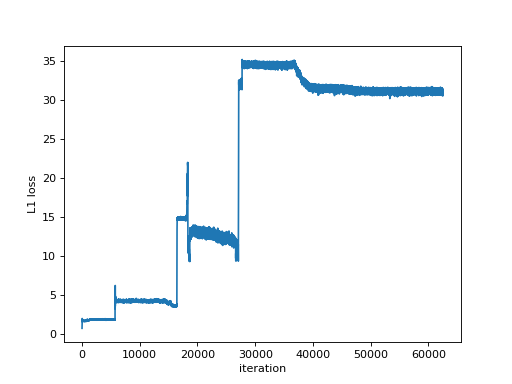

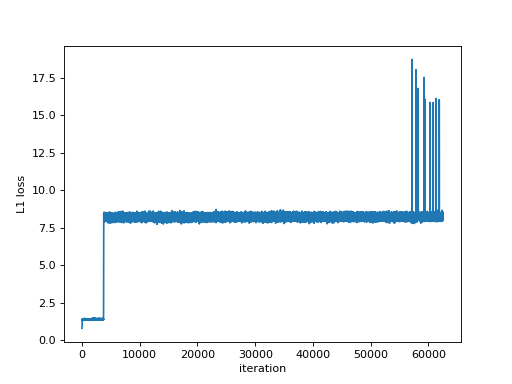

In [8]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pure_subtract_reset_beta_0.95')

### __784x784 random initialisation reset subtract beta 0.5__

In [9]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pure_subtract_reset_beta_0.5')
anims[0]

/home/jupyter-ikharitonov/.local/lib/python3.11/site-packages/matplotlib/animation.py:892: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


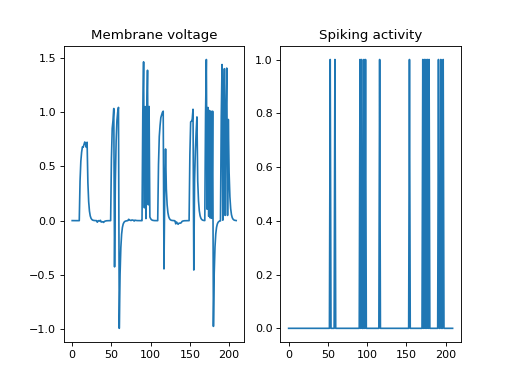

In [10]:
plot_traces(arrs[0])

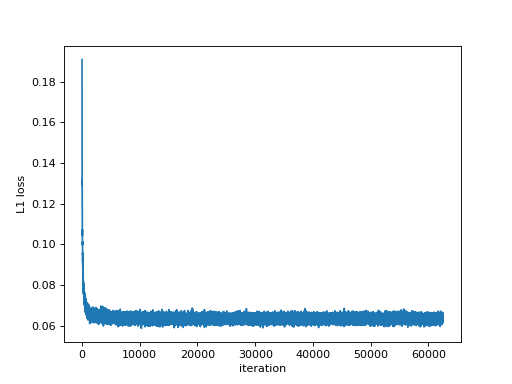

In [11]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pure_subtract_reset_beta_0.5')

### __784x784 random initialisation reset zero beta 0.95__

In [12]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pure_zero_reset_beta_0.95')
anims[0]

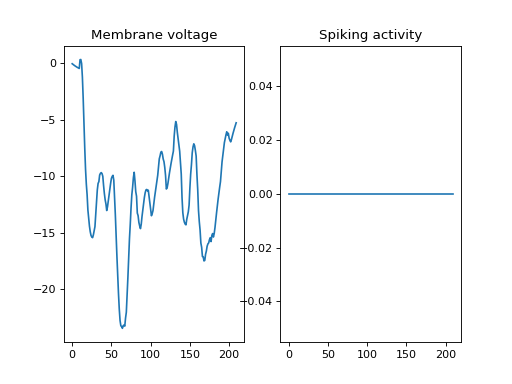

In [13]:
plot_traces(arrs[0])

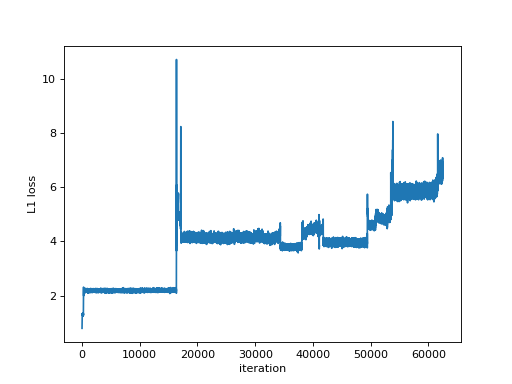

In [14]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pure_zero_reset_beta_0.95')

### __784x784 random initialisation reset zero beta 0.5__

In [15]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pure_zero_reset_beta_0.5')
anims[0]

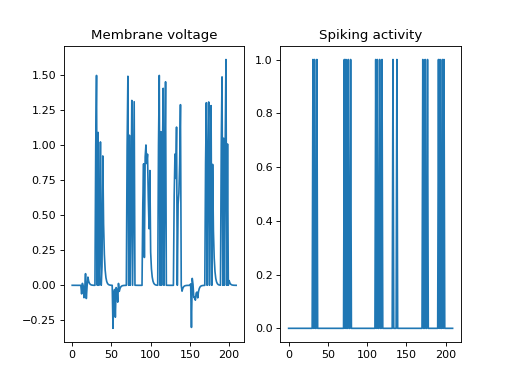

In [16]:
plot_traces(arrs[0])

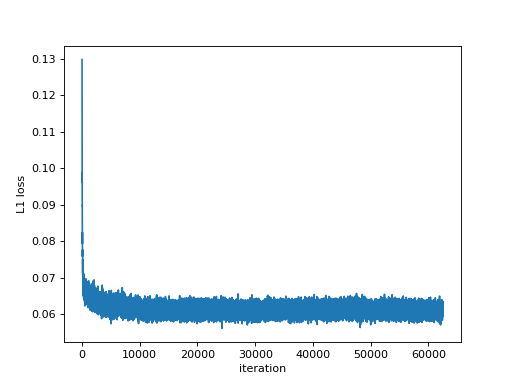

In [17]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pure_zero_reset_beta_0.5')

### __784x784 classification initialisation reset subtract beta 0.95__

In [18]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pretrained_subtract_reset_beta_0.95')
anims[0]

In [19]:
anims[1]

In [20]:
anims[2]

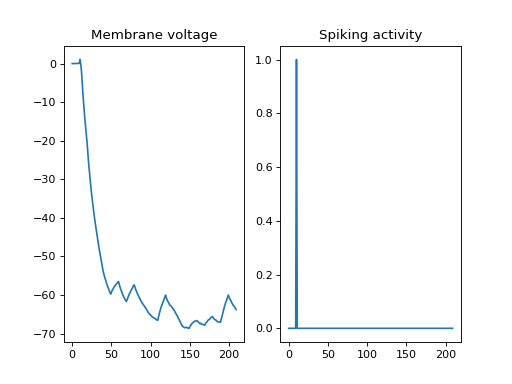

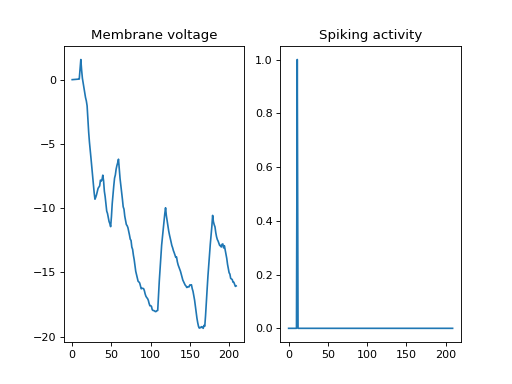

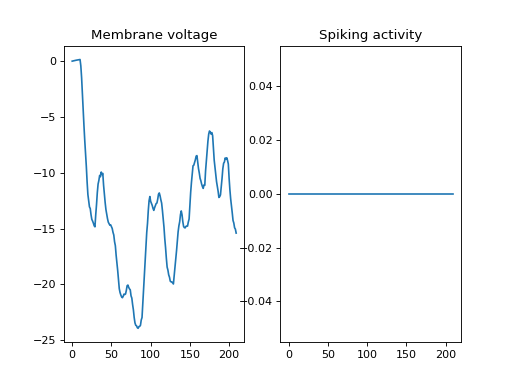

In [21]:
plot_traces(arrs[0])
plot_traces(arrs[1])
plot_traces(arrs[2])

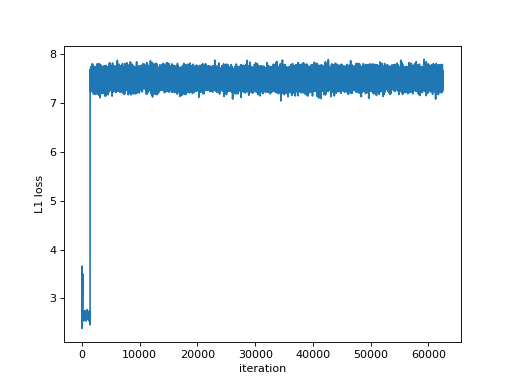

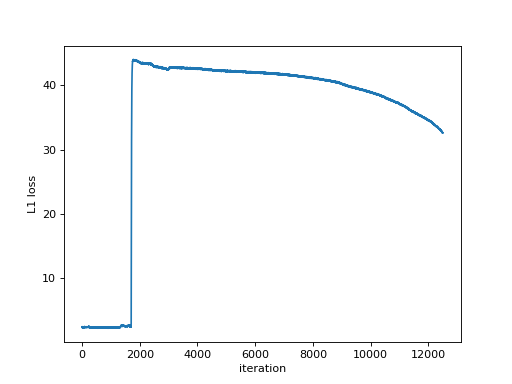

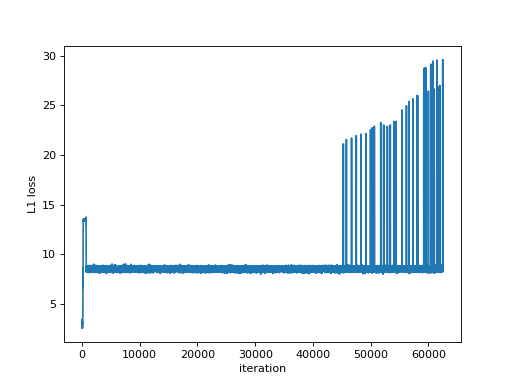

In [22]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pretrained_subtract_reset_beta_0.95')

### __784x784 classification initialisation reset subtract beta 0.5__

In [23]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pretrained_subtract_reset_beta_0.5')
anims[0]

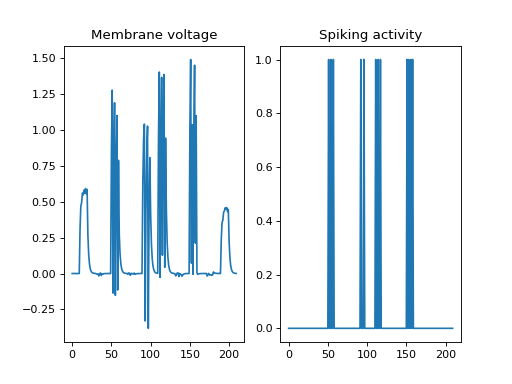

In [24]:
plot_traces(arrs[0])

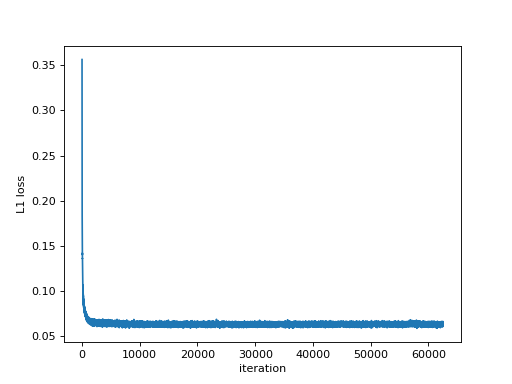

In [25]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pretrained_subtract_reset_beta_0.5')

### __784x784 classification initialisation reset zero beta 0.95__

In [26]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pretrained_zero_reset_beta_0.95')
anims[0]

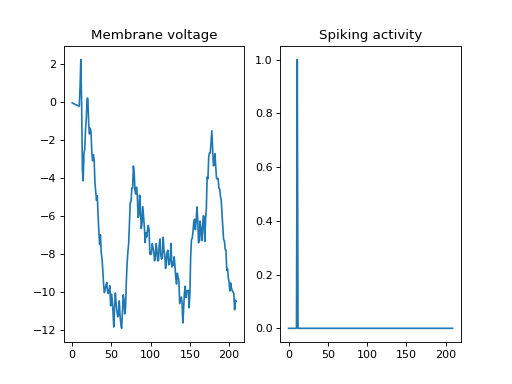

In [27]:
plot_traces(arrs[0])

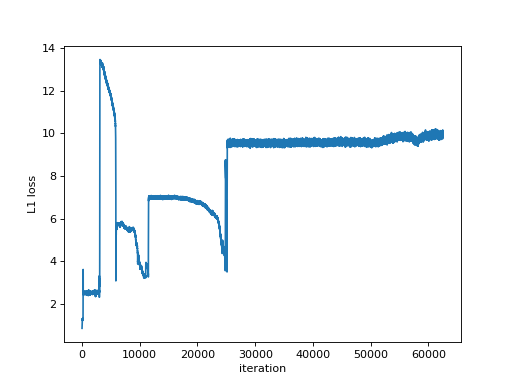

In [28]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pretrained_zero_reset_beta_0.95')

### __784x784 classification initialisation reset zero beta 0.5__

In [29]:
anims, arrs = plot_animations(base_path/'784x784_matrix_class_pretrained_zero_reset_beta_0.5')
anims[0]

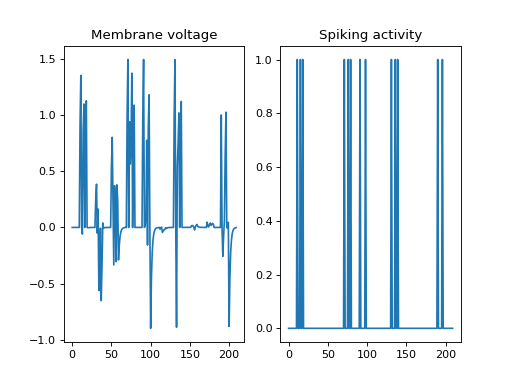

In [30]:
plot_traces(arrs[0])

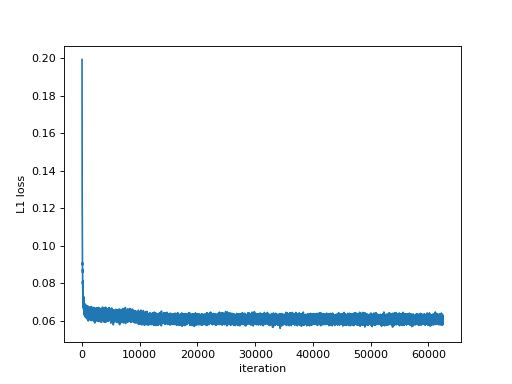

In [31]:
plt.close()
plot_loss(base_path/'784x784_matrix_class_pretrained_zero_reset_beta_0.5')

### __1024x1024 random initialisation reset zero beta 0.5__

In [32]:
anims, arrs = plot_animations(base_path/'1024x1024_matrix_class_pure_zero_reset_beta_0.5')
anims[0]

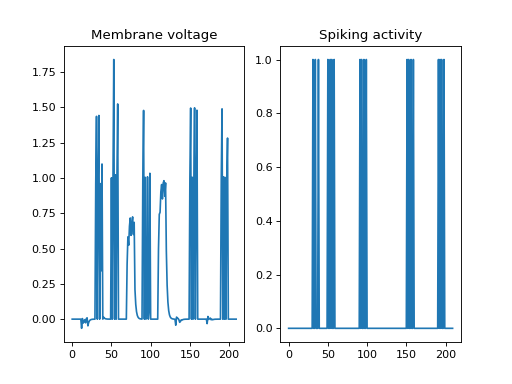

In [33]:
plot_traces(arrs[0])

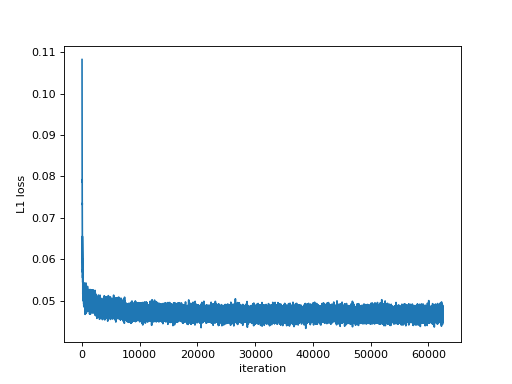

In [34]:
plt.close()
plot_loss(base_path/'1024x1024_matrix_class_pure_zero_reset_beta_0.5')

### __1024x1024 classification initialisation reset subtract beta 0.95__

In [35]:
anims, arrs = plot_animations(base_path/'1024x1024_matrix_class_pretrained_subtract_reset_beta_0.95')
anims[0]

In [36]:
anims[1]

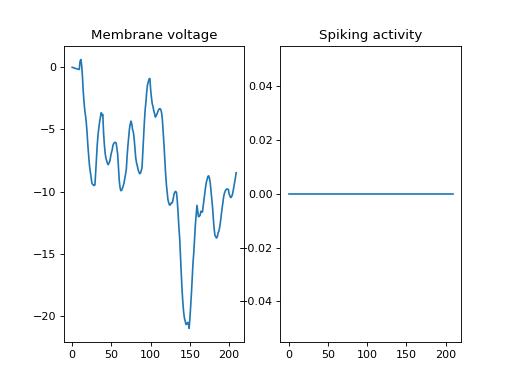

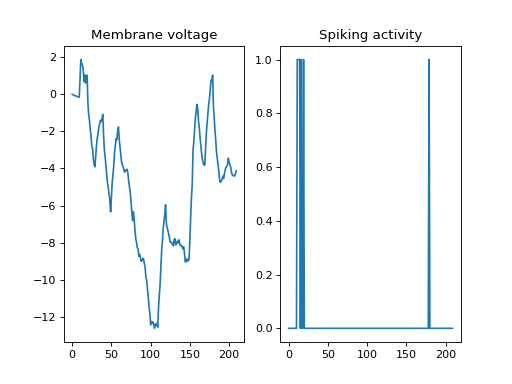

In [37]:
plot_traces(arrs[0])
plot_traces(arrs[1])

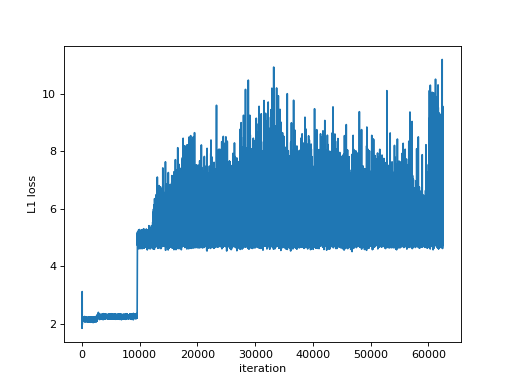

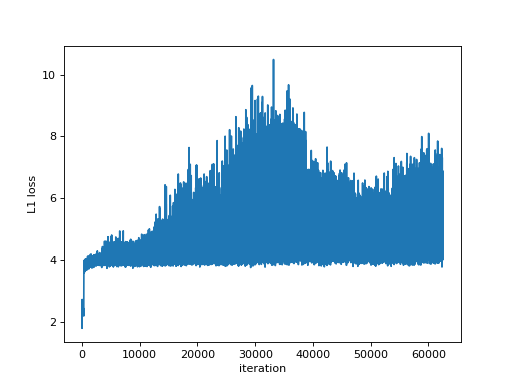

In [38]:
plt.close()
plot_loss(base_path/'1024x1024_matrix_class_pretrained_subtract_reset_beta_0.95')

### __1024x1024 classification initialisation reset zero beta 0.5__

In [39]:
anims, arrs = plot_animations(base_path/'1024x1024_matrix_class_pretrained_zero_reset_beta_0.5')
anims[0]

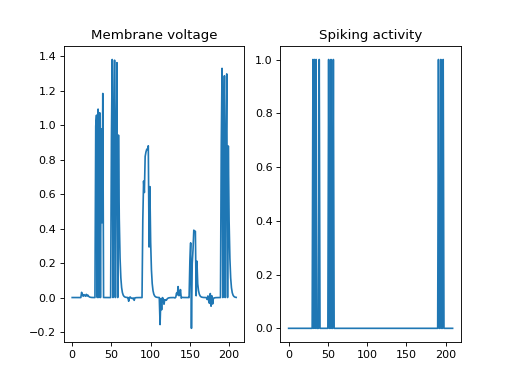

In [40]:
plot_traces(arrs[0])

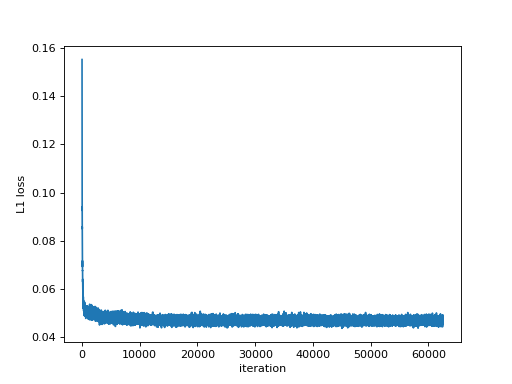

In [41]:
plt.close()
plot_loss(base_path/'1024x1024_matrix_class_pretrained_zero_reset_beta_0.5')